Many who follow politics have noticed that the tweets from [@RealDonaldTrump](https://twitter.com/realDonaldTrump) don't seem to be written by just one person. Some of them&mdash;often written early in the morning&mdash;use language that is unique to Donald Trump: insults to political opponents, attacks on the media, etc. Others&mdash;usually sent during normal working hours&mdash;include language that any President would use: stating policy positions, endorsing other Republicans, etc.

This notebook is my attempt to distinguish between Tweets worded in a Trumpy way and those worded Presidentially. I suspect the Trumpy tweets were actually written by Donald Trump, while the Presidential ones are usually written by White House staffers, though I have no inside knowledge on the matter. Regardless, I expect&mdash;based only on diction&mdash;that tweets from [@RealDonaldTrump](https://twitter.com/realDonaldTrump) will cluster into two groups. Let's see if I'm right about that.

# Imports and loading the data

We start by importing pandas and Altair. We're using Altair for visualization because it will allow us to easily make the complicated plots near the end of this notebook.

In [1]:
import pandas as pd
import altair as alt
alt.renderers.enable('notebook')

RendererRegistry.enable('notebook')

The tweets from [@RealDonaldTrump](https://twitter.com/realDonaldTrump) between inauguration day 2017 and October 11, 2018 are stored in `TrumpTweets.json`, which I created using the [Trump Twitter Archive](http://trumptwitterarchive.com/archive). We'll only use the text of the tweets for the analysis, but we will also use temporal data to verify that Trumpy tweets are sent early in the morning. The time data from Twitter's api is from the GMT timezone; we convert it to the Eastern time zone, where Trump is most of the time.

In [2]:
trump_tweets = pd.DataFrame(pd.read_json('TrumpTweets.json', encoding='utf-8')[['text', 'created_at']])

In [3]:
trump_tweets['created_at'] = pd.to_datetime(trump_tweets.created_at)

In [4]:
trump_tweets['created_at'] = trump_tweets.created_at.dt.tz_localize('GMT')

In [5]:
trump_tweets['created_at'] = trump_tweets.created_at.dt.tz_convert('US/Eastern')

In [6]:
trump_tweets.head(10)

,text,created_at
0,RT @FLGuard: There are serious communication i...,2018-10-11 18:49:26-04:00
1,RT @WhiteHouse: President Trump provides an up...,2018-10-11 18:14:23-04:00
2,"RT @WhiteHouse: Moments ago, President Trump s...",2018-10-11 13:23:27-04:00
3,https://t.co/xJ9QYGMJXa,2018-10-11 12:21:53-04:00
4,https://t.co/rsxEwbFZht,2018-10-11 10:43:33-04:00
5,https://t.co/h47S6T9u8V,2018-10-11 10:41:01-04:00
6,Florida Highway Patrol Troopers are all en rou...,2018-10-10 23:44:00-04:00
7,Thank you to @FEMA and all First Responders! #...,2018-10-10 21:35:15-04:00
8,Thank you Jacksonville Sheriff’s Office! #Hurr...,2018-10-10 21:33:21-04:00
9,"Massive overflow crowd tonight in Erie, Pennsy...",2018-10-10 21:00:18-04:00


# Preprocessing

Before we do any analysis with the tweets, it's important to preprocess them. I've written my own module, `preprocessing.py`, to take care of this for me. This module includes the function `preprocess_text`, which takes a string as input and:
 - removes urls
 - removes punctuation
 - removes capitalization
 - stems the words, which removes suffixes (e.g. 'preprocessing' becomes 'preprocess')

In [7]:
from preprocessing import preprocess_text

In [8]:
trump_tweets['text'] = trump_tweets.text.apply(preprocess_text)

Now that we've preprocessed all of the tweets, we are no longer interested in those that only contained urls (which are now blank). We are also not interested in retweets because we want to analyse tweets that actually came from the @RealDonaldTrump account. The below line removes both cases from the `trump_tweets` DataFrame.

In [9]:
trump_tweets = trump_tweets.loc[(trump_tweets.text != '') & (trump_tweets.text.str[:3] != 'rt ')]

In [10]:
trump_tweets.head()

,text,created_at
6,florida highway patrol trooper are all en rout...,2018-10-10 23:44:00-04:00
7,thank you to fema and all first respond hurric...,2018-10-10 21:35:15-04:00
8,thank you jacksonvil sheriff offic hurricanemi...,2018-10-10 21:33:21-04:00
9,massiv overflow crowd tonight in eri pennsylva...,2018-10-10 21:00:18-04:00
10,thank you eri pennsylvania rememb to get out a...,2018-10-10 20:52:29-04:00


We are now left with tweets that came from Donald Trump's Twitter account, and they have been stemmed and stripped of capitalization, punctuation, and urls. Let's see if we can find differences in the diction of tweets that cry "Witch Hunt!" and those that are more presidential.

# Unigrams

In the language of Natural Language Processing (NLP), single words are called _unigrams_. More generally, there are _bigrams_, which are occurances of pairs of words, and _ngrams_, which are occurances of n consecutive words. In this section, we'll only use the unigrams in tweets from @RealDonaldTrump to do the analysis.

## Tf-idf

One of the most common ways to quantify text data is to simply count the occurrances of each word in each tweet; this is called a _bag of words_ model. A weakness of these models is that the most commonly-used words tend to dominate the scores, while lesser-used words are usually more informative. A solution to this is term frequency-inverse document frequency, where the score for each word is weighted to account for (1) the length of the document (in our case, tweet) it appears in, and (2) the prevalence of the word in the entire corpus of documents (in our case, the collection of all @RealDonaldTrump tweets since Inauguration Day).

In scikit-learn, we obtain a tf-idf matrix whose rows represent tweets, and whose columns represent words. Each component of the matrix is the tf-idf score for that word in that tweet. For more details on scikit-learn's implementation of tf-idf, go [here](http://scikit-learn.org/stable/modules/feature_extraction.html#tfidf-term-weighting).

One more thing: very common words like "and" and "the" tend to dominate these scores, even when using idf weighting. We therefore don't consider them, and they do not get a column in the tf-idf matrix. These ignored words are called stop words, and scikit-learn has its own collection of them. To these, we add the words from Trump's campaign slogan, "make America great again", because they occur frequently in his tweets and do not give much information--the associated topics and tone of tweets including this phrase are quite varied. We also add "wa", which is the stemmed version of "was". Finally, with the `min_df` argument in scikit-learn's `TfidfVectorizer`, we specify that we only want a word to be counted if it appears at least four times in all @RealDonaldTrump tweets. This is because, in the Trump Twitter Archive, some deleted tweets appear, and thus there are sets of almost-identically-worded tweets. Since the wordings involved are sometimes unique, these pairs of tweets appear as outliers unless we specify `min_df = 4`.

In [11]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS
my_stop_words = ENGLISH_STOP_WORDS.union(['make', 'america', 'great', 'again', 'wa'])
tf_idf_vectorizer = TfidfVectorizer(stop_words= my_stop_words, min_df = 4)
tf_idf = tf_idf_vectorizer.fit_transform(trump_tweets.text)

It turns out that this section works better if we scale the columns of the tf-idf matrix; that is, if we subtract from each tf-idf score the mean of each column and then divide by each column's standard deviation. This will help the K-Means algorithm that we use below to not hone in on outliers in the data.

In [12]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaled_tf_idf = scaler.fit_transform(tf_idf.toarray())

## LSA

LSA, or Latent Semantic Analysis, is a fancy term for performing a singular value decomposition on the tf-idf matrix. Here, we will use LSA to visualize our data and get a sense for the differences between tweets. I also add the first two columns of the transformed tf-idf matrix&mdash;which is made up of the projections of the original matrix onto the first two right singular vectors&mdash;to our `trump_tweets` dataframe.

In [13]:
from sklearn.decomposition import TruncatedSVD
svdecomposer = TruncatedSVD(n_components = 50)
svd = svdecomposer.fit_transform(scaled_tf_idf)

In [14]:
trump_tweets['LSA1'] = svd[:,0]
trump_tweets['LSA2'] = svd[:,1]

Let's see what the data looks like when we plot the first two components from LSA:

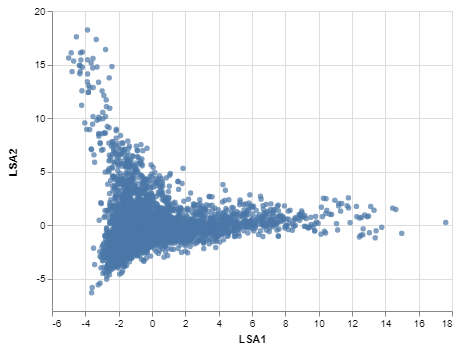

In [15]:
alt.Chart(trump_tweets).mark_circle().encode(
    x = 'LSA1',
    y = 'LSA2'
)

It looks like a lot tweets lie near both of these axes. But what do these axes mean? We've plotted the projection of each tweet onto the first two right singular vectors. Each of these vectors have components corresponding to words that appear in tweets from @RealDonaldTrump. We can use the values of these components to see what kind of tweets score high and low along these axes. The function defined below returns a DataFrame that shows, for each right singular vector, the component value corresponding to each word.

In [16]:
def get_term_weight_LSA(vectorizer, SVD):
    """Given already-fitted tfidf vectorizer and SVD object, returns a pandas DataFrame with the terms as its indices and
    weights corresponding to the right singular vectors as columns."""
    import pandas as pd
    
    feature_names = vectorizer.get_feature_names()
    components = SVD.components_
    df_columns_dict = {'LSA' + str(component_number + 1): 
                       components[component_number] for component_number in range(len(components))}
    term_weight_df = pd.DataFrame(data=df_columns_dict, index=feature_names)
    
    return term_weight_df.sort_values('LSA1', ascending=False)

In [17]:
LSA_term_weights = get_term_weight_LSA(tf_idf_vectorizer, svdecomposer)

In [18]:
LSA_term_weights['LSA1'].head(20)

fbi         0.171417
hillari     0.154235
clinton     0.145385
witch       0.143609
hunt        0.143447
strzok      0.127668
crook       0.124301
rig         0.123091
page        0.115448
collus      0.112374
lover       0.108211
comey       0.106068
peter       0.105968
dossier     0.103272
mueller     0.102516
email       0.099898
russia      0.099140
whi         0.098471
russian     0.097486
investig    0.097352
Name: LSA1, dtype: float64

In [19]:
LSA_term_weights['LSA1'].tail(20)

whitehous   -0.035143
vote        -0.035404
minist      -0.035509
welcom      -0.037348
cut         -0.038859
governor    -0.038878
unit        -0.038959
thank       -0.039624
nation      -0.041580
love        -0.042039
2nd         -0.043896
tax         -0.045283
amend       -0.048986
strong      -0.050518
endors      -0.052067
border      -0.053098
vet         -0.054401
militari    -0.054922
honor       -0.055301
today       -0.055612
Name: LSA1, dtype: float64

The first right singular vector has large positive components corresponding to words that we associate with Trump specifically; in particular, these words mention political rivals, like the DNC and Hillary Clinton, as well as investigations by the FBI and special counsel.

Meanwhile, this same vector has negative components corresponding to words that we might normally expect from a President: "honor," "military," and policy issues like "border," "trade," and "taxes."

In other words, the "LSA1" axis discriminates between tweets that are Trumpy and those that are Presidential. It is remarkable that we are able to do this using something as simple as a singular value decomposition.

What about the second right singular vector? What is the difference between tweets with a positive "LSA2" score and a negative "LSA2" score?

In [20]:
LSA_term_weights['LSA2'].sort_values(ascending=False).head(20)

crime          0.219573
amend          0.211870
endors         0.201012
border         0.199623
vet            0.194640
2nd            0.186976
strong         0.152552
militari       0.129080
vote           0.121462
troy           0.107225
congressman    0.106555
democrat       0.102248
pelosi         0.101785
nanci          0.100241
tough          0.099185
weak           0.098956
republican     0.098788
total          0.098614
puppet         0.098450
senat          0.096572
Name: LSA2, dtype: float64

In [21]:
LSA_term_weights['LSA2'].sort_values(ascending=False).tail(20)

prayer      -0.038424
jong        -0.040369
trade       -0.041119
flotu       -0.042524
melania     -0.043971
nation      -0.044205
kim         -0.045116
unit        -0.045221
china       -0.046097
xi          -0.047931
today       -0.048289
whitehous   -0.055288
north       -0.056452
meet        -0.058297
presid      -0.061064
welcom      -0.063253
korea       -0.065018
prime       -0.065105
minist      -0.065335
honor       -0.075106
Name: LSA2, dtype: float64

Tweets with a positive "LSA2" score tend to be about domestic policy ("crime," "2nd amendment," "border"), while those with a negative "LSA2" score tend to be about foreign policy, often mentioning foreign leaders like Xi Jinping, Shinzo Abe, and Kim Jong Un.

## K-Means

Now it's time to see if Trump's tweets belong to two different clusters: Trumpy and Presidential. If so, we expect that these two clusters will correspond to the left and right halves of the plot above.

We will use K-means clustering, which takes a specified number (K) of clusters. The idea here is to randomly place K cluster _centroids_, assign points to clusters according to which cluster centroid they are closest to, and then move the centroids to the mean position of the points in its cluster. These last two steps are repeated until the centroids no longer move. For more information on scikit-learn's implementation of this algorithm, see its [documentation](http://scikit-learn.org/stable/modules/clustering.html#k-means).

In [28]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=2, n_init = 100)
cluster_labels = kmeans.fit_predict(scaled_tf_idf)

In [29]:
trump_tweets['unigrams_cluster'] = cluster_labels

In [30]:
trump_tweets.unigrams_cluster.value_counts()

0    3395
1     975
Name: unigrams_cluster, dtype: int64

The K-means algorithm often converges to a local minimum and therefore assigns clusters sub-optimally. To mitigate this, K-means is usually run more than once. I've specified `n_int = 100`, meaning that the algorithm is repeated 100 times, when I defined the `KMeans` object. This usually results in a good clustering; if you run this notebook yourself, the output of the above cell should show ~3000 tweets in one cluster and ~1000 tweets in the other.

The actual label that K-means gives a cluster is random, meaning that even if K-means gave the same clusters every time, their labels would be different each time you ran the algorithm. My solution for this is to order the cluster labels by cluster size, so that the label `0` corresponds to the largest cluster, `1` to the next largest, etc. The function defined below takes a scikit-learn object as input and returns the same object, but with the labels and their associated centroids ordered according to cluster size.

In [31]:
def reorder_cluster_labels_and_centroids(KMeans):
    """Given a scikit-learn KMeans object, returns the same KMeans object but with the labels_ ordered according to
    cluster size and the cluster_centers_ also reordered accordingly."""
    import numpy as np
    unique_labels, old_label_counts = np.unique(KMeans.labels_, return_counts=True)
    sorted_unique_labels = np.flipud(np.argsort(old_label_counts))
    label_dict = {sorted_unique_labels[new_label]: new_label for new_label in range(len(unique_labels))}
    KMeans.labels_ = np.vectorize(label_dict.get)(KMeans.labels_)
    KMeans.cluster_centers_ = KMeans.cluster_centers_[sorted_unique_labels]
    return KMeans

In [33]:
kmeans = reorder_cluster_labels_and_centroids(kmeans)

In [34]:
trump_tweets['unigrams_cluster'] = kmeans.labels_

Let's see how these cluster labels correspond to Trumpiness.

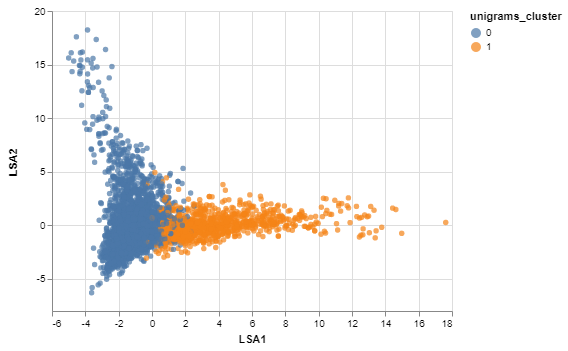

In [35]:
alt.Chart(trump_tweets).mark_circle().encode(
    x = 'LSA1',
    y = 'LSA2',
    color = 'unigrams_cluster:N'
)

Just like we hoped, it seems that the tweets from @RealDonaldTrump do cluster into two groups, and these two groups correspond to the Trumpiness of the language used. Let's modify the term_weight function above to work for K-means:

In [36]:
def get_term_weight_KMeans(vectorizer, KMeans):
    """Given an already-fitted tfidf vectorizer and a KMeans object, returns a pandas DataFrame with the terms as its indices and
    weights corresponding to the cluster centroids as columns."""
    import pandas as pd
    
    feature_names = vectorizer.get_feature_names()
    centroids = KMeans.cluster_centers_
    df_columns_dict = {'cluster' + str(cluster_number): 
                       centroids[cluster_number] for cluster_number in range(len(centroids))}
    term_weight_df = pd.DataFrame(data=df_columns_dict, index=feature_names)
    
    return term_weight_df.sort_values('cluster0', ascending=False)

In [37]:
term_weight_KMeans_unigrams = get_term_weight_KMeans(tf_idf_vectorizer, kmeans)

In [38]:
term_weight_KMeans_unigrams.head(20)

,cluster0,cluster1
today,0.057169,-0.199064
thank,0.055755,-0.194143
honor,0.055162,-0.192076
tax,0.054935,-0.191288
trade,0.052619,-0.183223
border,0.052238,-0.181894
unit,0.049165,-0.171193
cut,0.047692,-0.166068
countri,0.047629,-0.165846
nation,0.047281,-0.164635


In [39]:
term_weight_KMeans_unigrams.tail(20)

,cluster0,cluster1
rig,-0.106871,0.372129
phoni,-0.111616,0.388654
investig,-0.113556,0.395407
report,-0.114428,0.398443
campaign,-0.118670,0.413216
russia,-0.122964,0.428166
whi,-0.123284,0.429281
russian,-0.130415,0.454111
comey,-0.130827,0.455547
stori,-0.133623,0.465282


Indeed, the tweets positively associated with cluster 0, the presidential cluster, tend to be either unifying or about specific policy topics, whereas those positively associated with the Trumpy cluster tend to be about Hillary Clinton, investigations into his campain, or negative news coverage. This is clear enough that I'm going to relabel the clusters as "Presidential" and "Trumpy", which will make our last plot a little more clear. While I'm at it, I'll also relabel the axes and change the colors to be more informative.

In [40]:
unigrams_cluster_dict = {0: 'Presidential',
                         1: 'Trumpy'}
trump_tweets['Wording'] = trump_tweets['unigrams_cluster'].map(unigrams_cluster_dict)

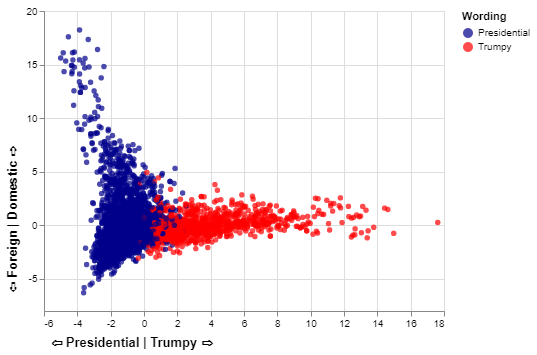

In [42]:
alt.Chart(trump_tweets).configure_axisX(
    titleFontSize = 13, 
    titleX = 87, 
    titleY = 25
).configure_axisY(
    titleFontSize = 13,
    titleY = 208,
    titleX = -25
).mark_circle().encode(
    x = alt.X('LSA1', axis = alt.Axis(title = '\u21e6 Presidential | Trumpy \u21e8')),
    y = alt.Y('LSA2', axis = alt.Axis(title = '\u21e6 Foreign | Domestic \u21e8')),
    color = alt.Color('Wording', scale = alt.Scale(domain = ['Presidential', 'Trumpy'], range=['darkBlue','red']))
)

At the beginning of this notebook, I noted how Trumpy tweets are often sent early in the morning. Let's see if the data agrees. below is a histogram showing the number of tweets by hour of the day.

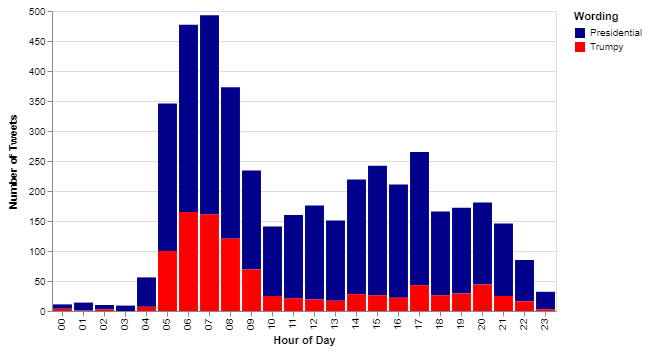

In [43]:
alt.Chart(trump_tweets).mark_bar().encode(
    x = alt.X('hours(created_at):O', axis = alt.Axis(title = 'Hour of Day')),
    y = alt.Y('count()', axis = alt.Axis(title = 'Number of Tweets')),
    color = alt.Color('Wording', scale = alt.Scale(
        domain = ['Presidential', 'Trumpy'], 
        range=['darkBlue','red']))
)

As expected, the Trumpy tweets are most often sent early in the morning, and the tweets sent during normal working hours are overwhelmingly presidential. Surprisingly, most of the early-morning tweets are in the Presidential cluster. I suspect that most early-morning tweets are, in fact, written by Trump; it is difficult to believe that White House staffers would feel the need to tweet from his account at 6:00 am. However, the wording of the "presidential" early-morning tweets do not make the authorship obvious. I suspect the clustering would work better if we took more than diction into account; the President's grammar has its own quirks, for example. Authorship clustering is an area of active research, and [this paper](https://people.cs.umass.edu/~pat/pdfs/Verga%20Efficient%20Authorship%20Clustering.pdf) by Verga et al. describes creating a similarity matrix by computing the [Imposter Similarity](https://pdfs.semanticscholar.org/5c2b/6876df693e096c6c150a5b0d2a2c05043003.pdf) between pairs of documents, and includes character ngrams as features. I suspect that method would work better than the relatively simple one presented here.

It seems, then, that the tweets in the Trumpy cluster are the ones that were most obviously written by Trump. We cannot interpret the Presidiential cluster as only including tweets written by staffers.

# Bigrams

So far, we've been successful at showing how some tweets from the @RealDonaldTrump are worded significantly differently than others. But there is a lot of overlap between our Trumpy and Presidential clusters. Let's see if we can get them to separate more.

One way to improve NLP algorigthms is to use bigrams. So far, the entries in our tf-idf matrix have been based on occurances of single words. This works to a degree, but it ignores the context in which the words are used, and so we lose some of the information in each tweet. One of the ways to include contextual information is to also look at pairs of consecutive words, called _bigrams_ in the NLP literature. We can use bigrams by setting the `ngrams_range` in scikit-learn's `TfidfVectorizer`.

In [45]:
bigrams_vectorizer = TfidfVectorizer(ngram_range = (1,2), stop_words= my_stop_words, min_df = 4)
bigrams = bigrams_vectorizer.fit_transform(trump_tweets.text)

## Visualization

Let's try to visualize what's going on here. We'll start with LSA again:

In [46]:
svd_bigrams = svdecomposer.fit_transform(bigrams)

In [47]:
trump_tweets['LSA1_bigrams'] = svd_bigrams[:,0]
trump_tweets['LSA2_bigrams'] = svd_bigrams[:,1]
trump_tweets['LSA3_bigrams'] = svd_bigrams[:,2]
trump_tweets['LSA4_bigrams'] = svd_bigrams[:,3]

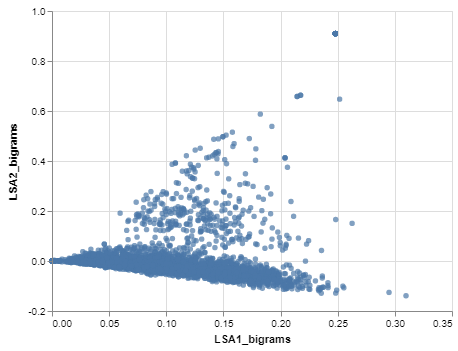

In [48]:
alt.Chart(trump_tweets).mark_circle().encode(
    x = 'LSA1_bigrams',
    y = 'LSA2_bigrams'
)

the chart above looks very different from what we had with the unigrams. One can maybe identify one cluster that is distinct from the mass near the LSA1_bigrams axis. Let's look at the next two dimensions we get from LSA:

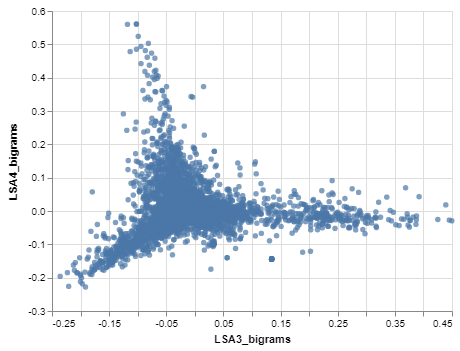

In [49]:
alt.Chart(trump_tweets).mark_circle().encode(
    x = 'LSA3_bigrams',
    y = 'LSA4_bigrams'
)

Here, we can see three clusters of tweets: those with a high LSA3_bigrams score, those with a high LSA4_bigrams score, and those with negative LSA3_bigrams and LSA4_bigrams scores. There seems to be a lot more going on here than there was with the unigrams. 


To get a better sense of this, let's use t-SNE. T-SNE attempts to take points in a high-dimensional space and map them to a 2- or 3-dimensional space. The positions in the low-dimensional space are based on pairwise distances: points close together in the high-dimensional space are usually placed close together in the low-dimensional space. It should therefore be useful in visualizing the clusters we have here. For more details on how T-SNE works, see [this introduction from O'Reilly](https://www.oreilly.com/learning/an-illustrated-introduction-to-the-t-sne-algorithm) or [the original paper from van der Maaten and Hinton](http://www.jmlr.org/papers/volume9/vandermaaten08a/vandermaaten08a.pdf). For more details on scikit-learn's implementation, see [their documentation](http://scikit-learn.org/stable/modules/manifold.html#t-distributed-stochastic-neighbor-embedding-t-sne).

In [50]:
from sklearn.manifold import TSNE
tsne = TSNE(learning_rate = 10)
embedding_bigrams = tsne.fit_transform(svd_bigrams)

In [51]:
trump_tweets['embedding1'] = embedding_bigrams[:,0]
trump_tweets['embedding2'] = embedding_bigrams[:,1]

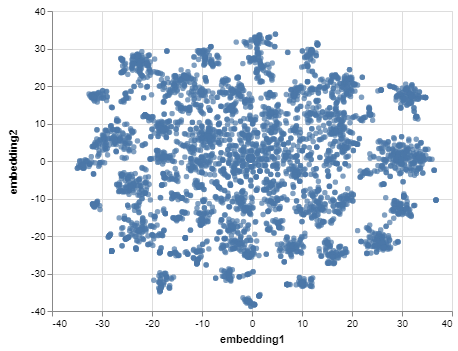

In [52]:
alt.Chart(trump_tweets).mark_circle().encode(
    x = 'embedding1',
    y = 'embedding2'
)

Note that t-SNE's cost function isn't convex, so if you run this notebook for yourself you plot is likely to look different from the one above. Regradless, we can see that there are definitely more than two clusters here. This will inform our K-means algorithm.

## KMeans

From a lot of trial-and-error, it seems that the optimal number of clusters is 17 when we're using bigrams. Let's run K-means with that knowledge:

In [53]:
kmeans_bigrams = KMeans(n_clusters = 17, n_init=100)
kmeans_bigrams.fit(bigrams)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=17, n_init=100, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [54]:
kmeans_bigrams = reorder_cluster_labels_and_centroids(kmeans_bigrams)

In [55]:
trump_tweets['bigrams_cluster'] = kmeans_bigrams.labels_

The default color scheme in Altair only has 10 colors, so to see all of the clusters clearly we're going to need to change the color scheme, which we do with the `scale` input.

In [56]:
scale = alt.Scale(scheme = 'category20')

Let's now look at how the t-SNE embedding plot looks when we color by cluster:

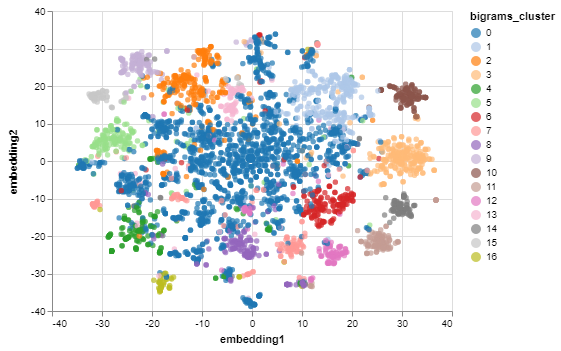

In [57]:
alt.Chart(trump_tweets).mark_circle().encode(
    x = 'embedding1',
    y = 'embedding2',
    color = alt.Color('bigrams_cluster:N', scale=scale)
)

It looks like the K-means clusters correspond pretty well with the t-SNE embeddings, but the largest cluster has far more tweets than the others, and dominates the chart. Let's chart all tweets other than that cluster.

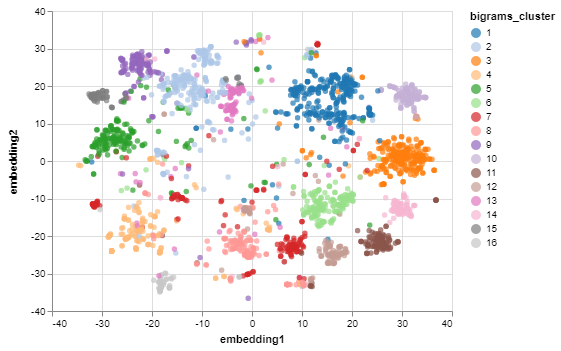

In [58]:
alt.Chart(trump_tweets.loc[trump_tweets.bigrams_cluster != 0]).mark_circle().encode(
    x = 'embedding1',
    y = 'embedding2',
    color = alt.Color('bigrams_cluster:N', scale=scale)
)

Now it is very clear the the clusters we see visually from t-SNE and those that K-means picks up on from the high-dimensional tf-idf data are nearly the same. This lends credence to the thought that these clusters represent something "real" in the data&mdash;these two independent, unsupervised learning algorithms came to much the same conclusions. But what do these clusters mean? What kind of words are in the tweets of each cluster? When we perform t-SNE, we lose the original high-dimensional data. However, we can still use the term-weight function we defined above to figure out what the K-means algorithm picked up on.

Full disclosure: due to the high number of clusters, K-means is especially likely to settle on a local optimum. This means that if you run this notebook for yourself, the clusters and their associated topics are likely to be different, though some clusters it picks up on consistently.

In [59]:
term_weights_bigrams = get_term_weight_KMeans(bigrams_vectorizer, kmeans_bigrams)

In [76]:
term_weights_bigrams.sort_values('cluster1', ascending=False).cluster1.head(20)

fbi                0.072556
hillari            0.057255
clinton            0.052040
comey              0.045750
trump              0.041198
campaign           0.040651
russia             0.039576
investig           0.039492
crook              0.037381
whi                0.036282
collus             0.035541
crook hillari      0.033145
hillari clinton    0.032103
russian            0.031472
jame               0.026559
jame comey         0.025701
obama              0.025249
did                0.021879
inform             0.021379
dnc                0.020824
Name: cluster1, dtype: float64

The tweets in cluster 1 tend to talk about Hillary Clinton and/or the FBI investigation into her campaign. . What about the rest? You can modify the above cell to look at the weights corresponding to other terms. I've done so, and it seems as if the rest of the clusters can be labelled as follows:

| Cluster Label | Topic |
| -------:|:-----:|
| 0 | Miscellaneous |
| 1 | Hillary Clinton/FBI |
| 2 | Politics and Votes |
| 3 | The Media |
| 4 | "Thank you" |
| 5 | Immigration |
| 6 | Trade |
| 7 | United States |
| 8 | Welcoming Foreign Leaders |
| 9 | Taxes |
| 10 | Mueller Investigation |
| 11 | Korea and China |
| 12 | "I look forward to..." |
| 13 | "Congratulations" | 
| 14 | White House |
| 15 | Endorsements |
| 16 | "Happy Birthday" |

Again, if you run K-means for yourself, you are likely to get slightly different clusters. However, the following clusters show up almost every time:
 - Hillary Clinton/FBI
 - The Media
 - "Thank you"
 - Immigration
 - Trade
 - Welcoming Foreign Leaders
 - Taxes
 - Endorsements
 - "Happy Birthday"

The Mueller Investigation cluster is also usually there, though sometimes it merges with Hillary Clinton/FBI. Otherwise, the exact topics K-means settles on vary.

As implied by the chart above, the clusters we get when including bigrams in our terms correspond to specific topics that @RealDonaldTrump often tweets about. But what about our original question? Are Trumpier tweets better-separated from the Presidential tweets? To find out, we can use the result of our clustering when we purely used unigrams. Let's also label the more specific clusters we just got according to topic rather than number:

In [77]:
topic_dict = {
    0: 'Miscellaneous',
    1: 'Hillary Clinton/FBI',
    2: 'Politics and Votes',
    3: 'The Media',
    4: ''"Thank you"'',
    5: 'Immigration',
    6: 'Trade',
    7: 'United States',
    8: 'Welcoming Foreign Leaders',
    9: 'Taxes',
    10: 'Mueller Investigation',
    11: 'Korea and China',
    12: '"I look forward to..."',
    13: '"Congratulations"',
    14: 'White House',
    15: 'Endorsements',
    16: '"Happy Birthday"'
}

trump_tweets['Topic'] = trump_tweets.bigrams_cluster.map(topic_dict)

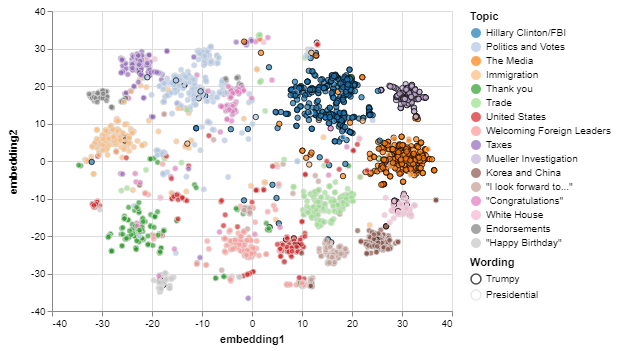

In [79]:
alt.Chart(trump_tweets.loc[trump_tweets.Topic != 'Miscellaneous']).mark_circle(strokeWidth=1).encode(
    x = 'embedding1',
    y = 'embedding2',
    fill = alt.Color('Topic', scale=scale, sort = alt.EncodingSortField(field = 'Topic', op = 'count', order = 'descending')),
    stroke = alt.Color('Wording', legend = alt.Legend(title = 'Wording'), 
                       scale = alt.Scale(
                           domain = ['Trumpy', 'Presidential'], 
                           range = ['black','#e0e0e0']))
)

So after including the bigrams information, the Trumpy tweets (which have a black outline) still cluster in the same area of the t-SNE embedding, and they are better-separated than when we used unigrams. We now see that they're split among several topics. How do the topics break down with respect to Trumpiness?

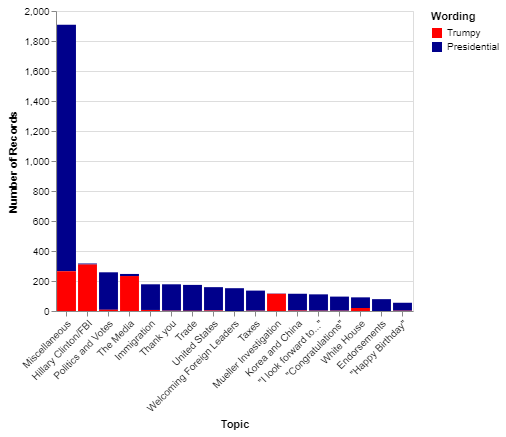

In [91]:
alt.Chart(trump_tweets).mark_bar().configure_axisX(
    labelAngle = -45
).encode(
    x = alt.X('Topic', sort = alt.EncodingSortField(field = 'Topic', op = 'count', order = 'descending')),
    y = alt.Y('count()'),
    color = alt.Color(field='Wording', type='nominal',
                      scale = alt.Scale(domain = ['Trumpy', 'Presidential'], range = ['red', 'darkBlue'])
                     )
)

These break down as one might expect: when President Trump talks about Hillary Clinton, media coverage, and the Mueller investigation, he uses Trumpy language; meanwhile, when @RealDonaldTrump tweets about policies, endorsements, and visits from foreign leaders, the language used is much more presidential. The histogram below is the same as above, except without the miscellaneous cluster:

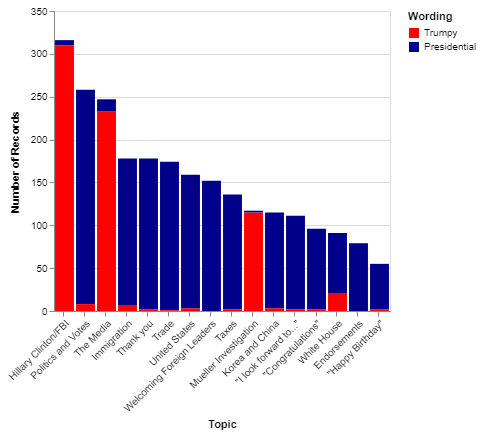

In [92]:
alt.Chart(trump_tweets.loc[trump_tweets.Topic != 'Miscellaneous']).mark_bar().configure_axisX(
    labelAngle = -45
).encode(
    x = alt.X('Topic', sort = alt.EncodingSortField(field = 'Topic', op = 'count', order = 'descending')),
    y = alt.Y('count()'),
    color = alt.Color(field='Wording', type='nominal', 
                      scale = alt.Scale(domain = ['Trumpy', 'Presidential'], range = ['red', 'darkBlue']))
)